# CBSD68 Denoising Dataset

In [1]:
import os

current_dir = os.getcwd()
print("Current directory:", current_dir)

Current directory: /home/mkang2/Convolutional-Nearest-Neighbor/Testing


In [2]:
# Torch
import torch 
import torch.nn as nn
import torch.nn.functional as F
from torch import optim 
from torchsummary import summary
from torchvision.transforms import v2
import numpy as np


# Train + Data 
import sys 
sys.path.append('../Layers')
from Conv1d_NN import *
from Conv2d_NN import *

from Conv1d_NN_spatial import * 
from Conv2d_NN_spatial import * 


from ConvNN_CNN_Branching import *

from Conv1d_NN_Attn import *
from Conv2d_NN_Attn import * 

sys.path.append('../Data')
from CBSD68 import NoisyCBSD68_dataset, test_denoise_visual_CBSD


sys.path.append('../Models')
from denoising_models import DenoisingCNN, DenoisingBranching_ConvNN_2D_Spatial_K_N, DenoisingBranching_ConvNN_2D_K_N, DenoisingConvNN_2D_K_N, DenoisingBranching_ConvNN_2D_K_All, DenoisingConvNN_2D_Attn_K_All, DenoisingConvNN_2D_Attn_K_N, DenoisingBranching_ConvNN_2D_Attn_K_N 

sys.path.append('../Train')
from train2d import train_denoising_model, evaluate_denoising_accuracy, evaluate_accuracy_psnr


import numpy as np



In [3]:
noisycbsd68 = NoisyCBSD68_dataset(batch_size=32, noise_std=0.3, train_count=1000, test_count=200, target_size=256)

In [4]:
print(len(noisycbsd68.train_data))
print(len(noisycbsd68.test_data))
print(len(noisycbsd68.test_data[0]))
print(noisycbsd68.train_data[0][0].shape)


1000
200
3
torch.Size([3, 256, 256])


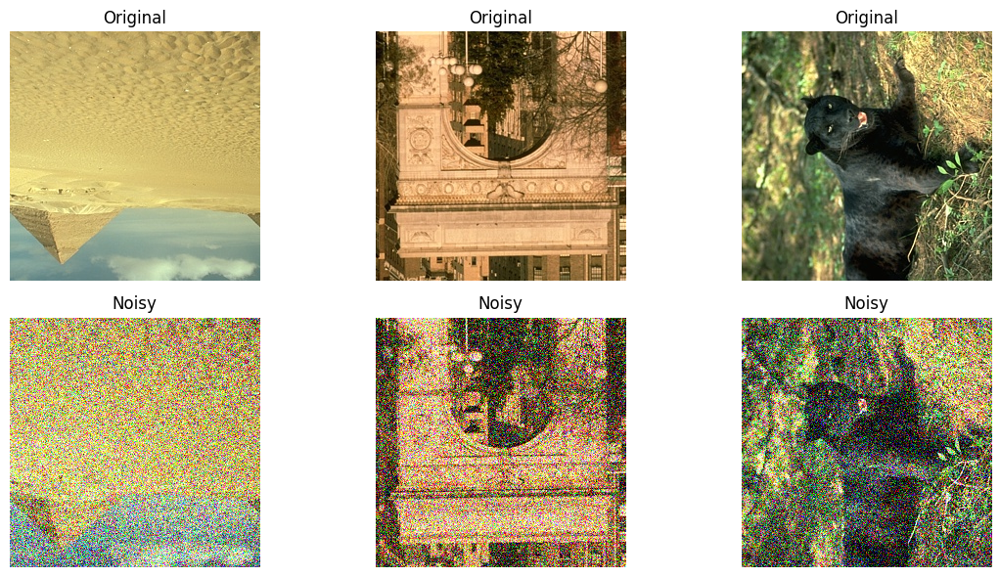

In [5]:
noisycbsd68.visual(3)

### Control CNN Model



Epoch 1, Time: 5.419754981994629, Loss: 0.046338440268300474
Epoch 2, Time: 5.158192157745361, Loss: 0.014073981845285743
Epoch 3, Time: 5.1179563999176025, Loss: 0.011709194746799767
Epoch 4, Time: 5.126269578933716, Loss: 0.009545266366330907
Epoch 5, Time: 5.147050619125366, Loss: 0.007835606957087293
Epoch 6, Time: 5.054463863372803, Loss: 0.007382094758213498
Epoch 7, Time: 5.05138087272644, Loss: 0.007107437762897462
Epoch 8, Time: 5.281387805938721, Loss: 0.00688007018470671
Epoch 9, Time: 5.0926353931427, Loss: 0.006659081860561855
Epoch 10, Time: 5.0530030727386475, Loss: 0.006538196190376766

 Average epoch time: 5.1502094745635985
Average loss on test set: 0.006610228946166379


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.13513954..1.0946778].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.016223338..1.0929731].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.029351752..1.0647465].


Average PSNR on test set: 21.933993203299387


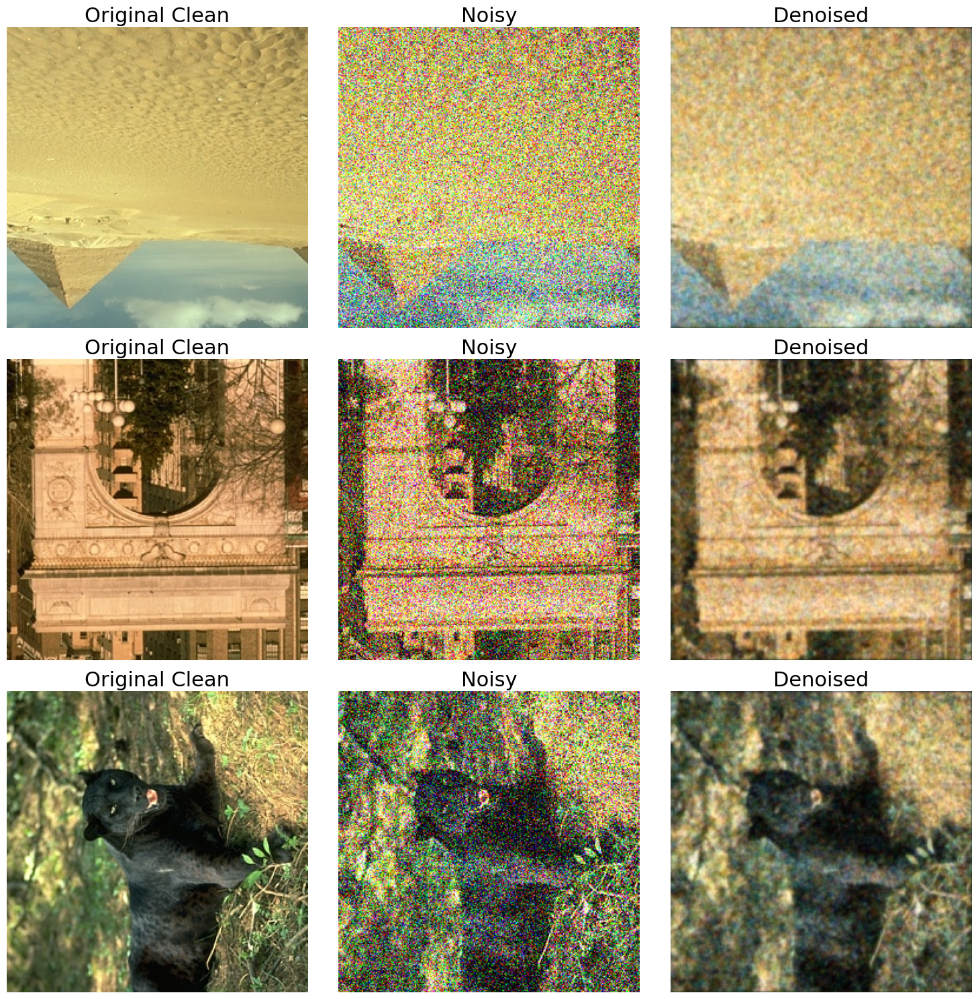

In [6]:
# CNN control model 
CNN = DenoisingCNN(in_ch=3, out_ch=3, kernel_size=3, device='cuda')

criterion = nn.MSELoss()
optimizer = optim.Adam(CNN.parameters(), lr=0.001)
num_epochs = 10
train_denoising_model(CNN, noisycbsd68.train_loader, criterion, optimizer, num_epochs, device='cuda')
evaluate_denoising_accuracy(CNN, noisycbsd68.test_loader, criterion, device='cuda')
evaluate_accuracy_psnr(CNN, noisycbsd68.test_loader, criterion, device='cuda')


# Print out output of trained model
test_denoise_visual_CBSD(CNN, noisycbsd68.test_data, device='cuda')


## Branching Model

Epoch 1, Time: 11.993102312088013, Loss: 0.1636910263914615
Epoch 2, Time: 11.597850799560547, Loss: 0.060755807207897305
Epoch 3, Time: 12.032713651657104, Loss: 0.02245244412915781
Epoch 4, Time: 11.683009386062622, Loss: 0.014486482396023348
Epoch 5, Time: 11.652508735656738, Loss: 0.012598670582519844
Epoch 6, Time: 11.707603454589844, Loss: 0.011962590651819482
Epoch 7, Time: 11.686855554580688, Loss: 0.011323233746225014
Epoch 8, Time: 11.699052810668945, Loss: 0.010904258117079735
Epoch 9, Time: 11.88010573387146, Loss: 0.010418235382530838
Epoch 10, Time: 11.93662714958191, Loss: 0.010044284877949394

 Average epoch time: 11.786942958831787
Average loss on test set: 0.010386766732803412
Average PSNR on test set: 19.818195343017578


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.05368495..0.9976994].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.013340682..0.95184326].


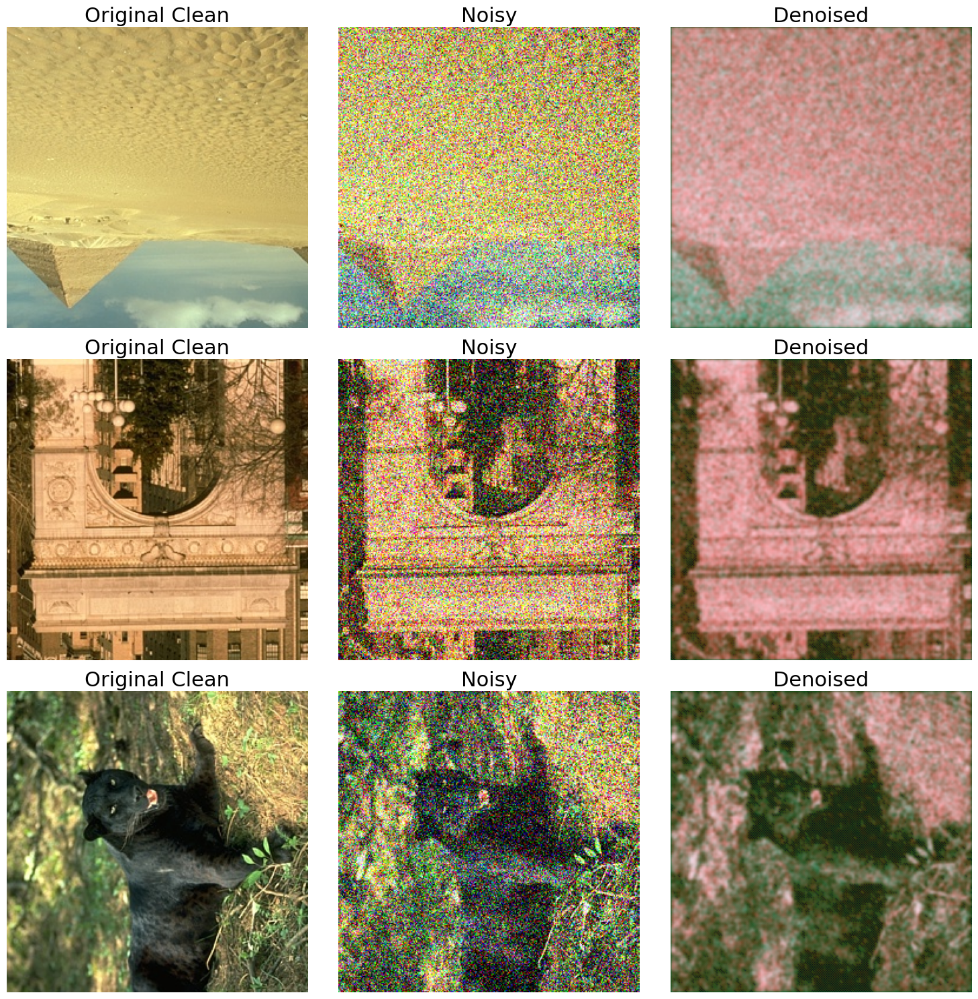

In [7]:
# Denoising Branching CNN + ConvNN Spatial, K = 9, N = 22 (484), 16:16
denoisingbranching_convNN_spatial_K_N_16_16 = DenoisingBranching_ConvNN_2D_Spatial_K_N(in_ch=3, out_ch=3, K=9, N=22, device='cuda')

criterion = nn.MSELoss()
optimizer = optim.Adam(denoisingbranching_convNN_spatial_K_N_16_16.parameters(), lr=0.001)
num_epochs = 10
train_denoising_model(denoisingbranching_convNN_spatial_K_N_16_16, noisycbsd68.train_loader, criterion, optimizer, num_epochs, device='cuda')
evaluate_denoising_accuracy(denoisingbranching_convNN_spatial_K_N_16_16, noisycbsd68.test_loader, criterion, device='cuda')
evaluate_accuracy_psnr(denoisingbranching_convNN_spatial_K_N_16_16, noisycbsd68.test_loader, criterion, device='cuda')

# Print out output of trained model
test_denoise_visual_CBSD(denoisingbranching_convNN_spatial_K_N_16_16, noisycbsd68.test_data, device='cuda')


Epoch 1, Time: 11.71825909614563, Loss: 0.08376627223333344
Epoch 2, Time: 11.727609157562256, Loss: 0.01885455142473802
Epoch 3, Time: 11.692450046539307, Loss: 0.014012558647664264
Epoch 4, Time: 11.57405161857605, Loss: 0.012335686769802123
Epoch 5, Time: 11.507047414779663, Loss: 0.010264763128361665
Epoch 6, Time: 11.574260473251343, Loss: 0.00823763535299804
Epoch 7, Time: 11.7344651222229, Loss: 0.00764448415429797
Epoch 8, Time: 11.597503185272217, Loss: 0.007443613241775893
Epoch 9, Time: 11.624115467071533, Loss: 0.007213732853415422
Epoch 10, Time: 11.43510127067566, Loss: 0.006958164740353823

 Average epoch time: 11.618486285209656
Average loss on test set: 0.006819029737796102


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07053913..0.9742218].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.041448787..0.90987855].


Average PSNR on test set: 21.600380216326034


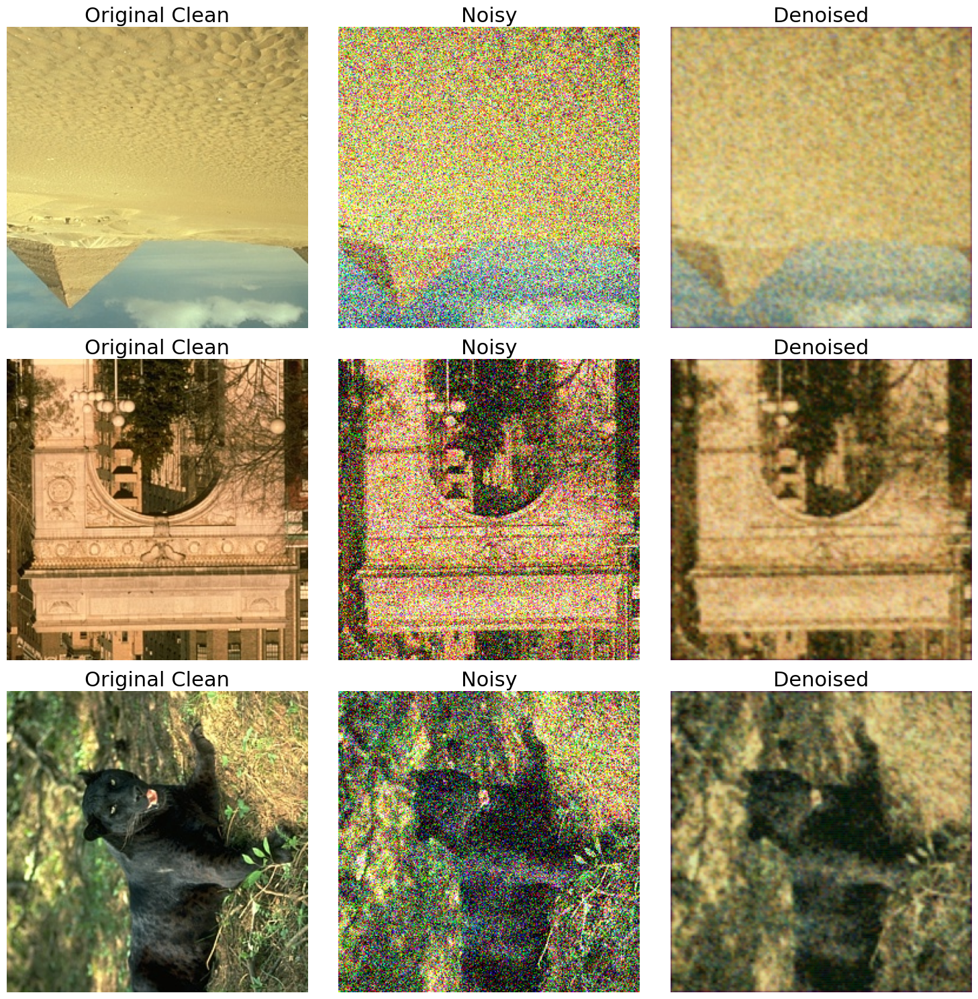

In [8]:
# Denoising Branching CNN + ConvNN Spatial, K = 9, N = 484, 16:16
denoisingbranching_convNN_K_N_16_16 = DenoisingBranching_ConvNN_2D_K_N(in_ch=3, out_ch=3, K=9, N=484, device='cuda')

criterion = nn.MSELoss()
optimizer = optim.Adam(denoisingbranching_convNN_K_N_16_16.parameters(), lr=0.001)
num_epochs = 10 
train_denoising_model(denoisingbranching_convNN_K_N_16_16, noisycbsd68.train_loader, criterion, optimizer, num_epochs, device='cuda')
evaluate_denoising_accuracy(denoisingbranching_convNN_K_N_16_16, noisycbsd68.test_loader, criterion, device='cuda')
evaluate_accuracy_psnr(denoisingbranching_convNN_K_N_16_16, noisycbsd68.test_loader, criterion, device='cuda')

# Print out output of trained model
test_denoise_visual_CBSD(denoisingbranching_convNN_K_N_16_16, noisycbsd68.test_data, device='cuda')



Epoch 1, Time: 34.156803131103516, Loss: 0.039502913889009506
Epoch 2, Time: 34.35284972190857, Loss: 0.016503868566360325
Epoch 3, Time: 34.165608644485474, Loss: 0.009335516559076495
Epoch 4, Time: 34.06668996810913, Loss: 0.007562738945125602
Epoch 5, Time: 34.03026723861694, Loss: 0.006934405115316622
Epoch 6, Time: 34.04640817642212, Loss: 0.006643518412602134
Epoch 7, Time: 34.03449463844299, Loss: 0.006421095706173219
Epoch 8, Time: 34.04904627799988, Loss: 0.006400855607353151
Epoch 9, Time: 33.9743971824646, Loss: 0.00616535147128161
Epoch 10, Time: 34.06364369392395, Loss: 0.006063677443307824

 Average epoch time: 34.094020867347716
Average loss on test set: 0.0060382263202752385


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.14811464..1.0423303].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.012330741..1.0728152].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.027169079..1.0456673].


Average PSNR on test set: 22.215420859200613


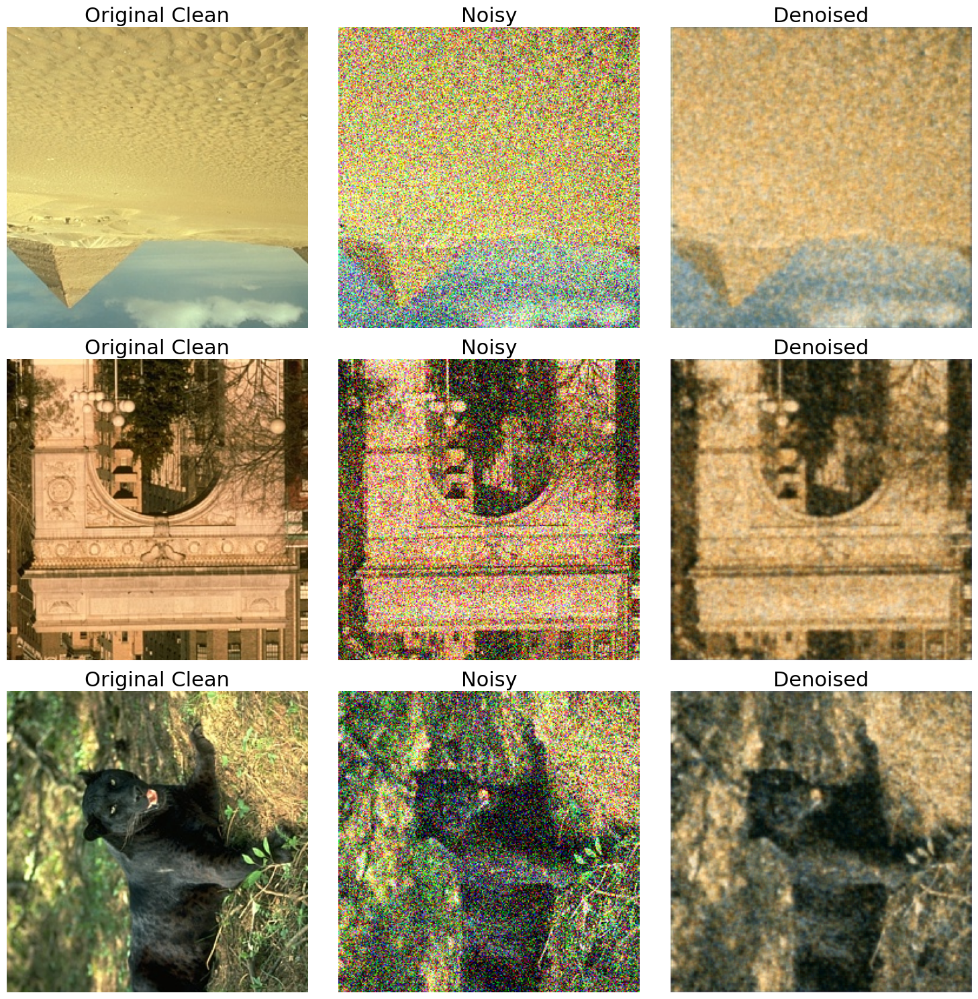

In [9]:
# Denoising Branching CNN + ConvNN, K = 9, N = All, 16:16
denoisingbranching_convNN_K_All_16_16 = DenoisingBranching_ConvNN_2D_K_All(in_ch=3, out_ch=3, K=9, device='cuda')

criterion = nn.MSELoss()
optimizer = optim.Adam(denoisingbranching_convNN_K_All_16_16.parameters(), lr=0.001)
num_epochs = 10 
train_denoising_model(denoisingbranching_convNN_K_All_16_16, noisycbsd68.train_loader, criterion, optimizer, num_epochs, device='cuda')
evaluate_denoising_accuracy(denoisingbranching_convNN_K_All_16_16, noisycbsd68.test_loader, criterion, device='cuda')
evaluate_accuracy_psnr(denoisingbranching_convNN_K_All_16_16, noisycbsd68.test_loader, criterion, device='cuda')

# Print out output of trained model
test_denoise_visual_CBSD(denoisingbranching_convNN_K_All_16_16, noisycbsd68.test_data, device='cuda')



Epoch 1, Time: 42.06303668022156, Loss: 0.9461608338169754
Epoch 2, Time: 41.67357420921326, Loss: 0.21042921813204885
Epoch 3, Time: 41.69187092781067, Loss: 0.17771935183554888
Epoch 4, Time: 41.62344837188721, Loss: 0.1265009599737823
Epoch 5, Time: 41.62316298484802, Loss: 0.09110656811390072
Epoch 6, Time: 41.63692378997803, Loss: 0.07330932340119034
Epoch 7, Time: 41.609034299850464, Loss: 0.06398575007915497
Epoch 8, Time: 41.49473762512207, Loss: 0.060025874990969896
Epoch 9, Time: 41.68691563606262, Loss: 0.05949159793090075
Epoch 10, Time: 41.74008774757385, Loss: 0.05755950335878879

 Average epoch time: 41.68427922725677
Average loss on test set: 0.0573782143848283


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0947621..3.2284775].


Average PSNR on test set: 12.2617370060512


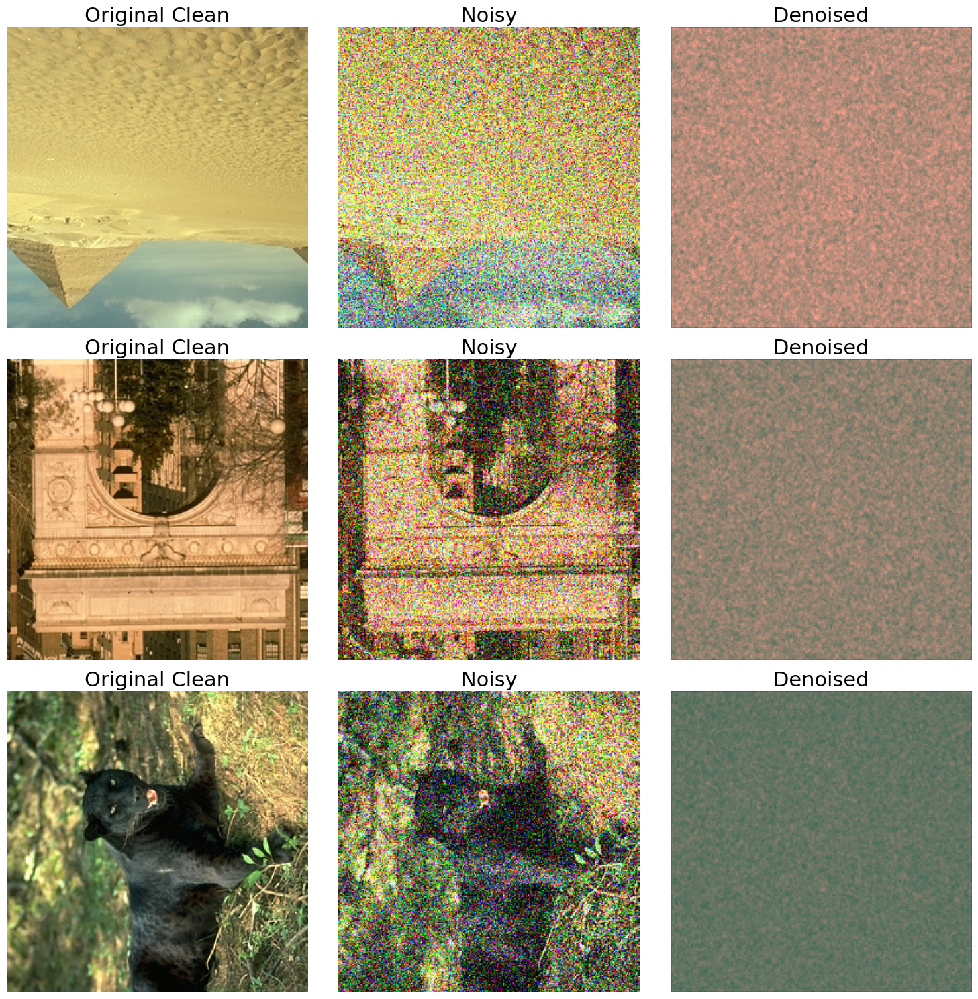

In [10]:
# Denoising Branching CNN + ConvNN_Attn, K = 9, N = 484, 16:16
denoisingbranching_convNN_attn_K_484_16_16 = DenoisingBranching_ConvNN_2D_Attn_K_N(in_ch=3, out_ch=3, K=9, device='cuda', N=484, image_size=(256, 256))

criterion = nn.MSELoss()
optimizer = optim.Adam(denoisingbranching_convNN_attn_K_484_16_16.parameters(), lr=0.001)
num_epochs = 10 
train_denoising_model(denoisingbranching_convNN_attn_K_484_16_16, noisycbsd68.train_loader, criterion, optimizer, num_epochs, device='cuda')
evaluate_denoising_accuracy(denoisingbranching_convNN_attn_K_484_16_16, noisycbsd68.test_loader, criterion, device='cuda')
evaluate_accuracy_psnr(denoisingbranching_convNN_attn_K_484_16_16, noisycbsd68.test_loader, criterion, device='cuda')

# Print out output of trained model
test_denoise_visual_CBSD(denoisingbranching_convNN_attn_K_484_16_16, noisycbsd68.test_data, device='cuda')



In [11]:
# Denoising Branching CNN + ConvNN_Attn, K = 9, N = All, 16:16
denoisingbranching_convNN_attn_K_All_16_16 = DenoisingBranching_ConvNN_2D_Attn_K_N(in_ch=3, out_ch=3, K=9, device='cuda', N="all", image_size=(256, 256))

criterion = nn.MSELoss()
optimizer = optim.Adam(denoisingbranching_convNN_attn_K_All_16_16.parameters(), lr=0.001)
num_epochs = 10 
train_denoising_model(denoisingbranching_convNN_attn_K_All_16_16, noisycbsd68.train_loader, criterion, optimizer, num_epochs, device='cuda')
evaluate_denoising_accuracy(denoisingbranching_convNN_attn_K_All_16_16, noisycbsd68.test_loader, criterion, device='cuda')
evaluate_accuracy_psnr(denoisingbranching_convNN_attn_K_All_16_16, noisycbsd68.test_loader, criterion, device='cuda')

# Print out output of trained model
test_denoise_visual_CBSD(denoisingbranching_convNN_attn_K_All_16_16, noisycbsd68.test_data, device='cuda')



OutOfMemoryError: CUDA out of memory. Tried to allocate 32.00 GiB. GPU 

### Non Branching

In [ ]:
# ConvNN K = 9, N = 484
denoising_convNN_2D_K_N = DenoisingConvNN_2D_K_N(in_ch=3, out_ch=3, K=9, N=484, device='cuda')

criterion = nn.MSELoss()
optimizer = optim.Adam(denoising_convNN_2D_K_N.parameters(), lr=0.001)
num_epochs = 10
train_denoising_model(denoising_convNN_2D_K_N, noisycbsd68.train_loader, criterion, optimizer, num_epochs, device='cuda')
evaluate_denoising_accuracy(denoising_convNN_2D_K_N, noisycbsd68.test_loader, criterion, device='cuda')
evaluate_accuracy_psnr(denoising_convNN_2D_K_N, noisycbsd68.test_loader, criterion, device='cuda')

# Print out output of trained model
test_denoise_visual_CBSD(denoising_convNN_2D_K_N, noisycbsd68.test_data, device='cuda')



In [12]:
# ConvNN_Attn K = 9, N = 484
denoising_convNN_attn_2D_K_N = DenoisingConvNN_2D_Attn_K_N(in_ch=3, out_ch=3, K=9, N=484, device='cuda', image_size=(256, 256))

criterion = nn.MSELoss()
optimizer = optim.Adam(denoising_convNN_attn_2D_K_N.parameters(), lr=0.001)
num_epochs = 10
train_denoising_model(denoising_convNN_attn_2D_K_N, noisycbsd68.train_loader, criterion, optimizer, num_epochs, device='cuda')
evaluate_denoising_accuracy(denoising_convNN_attn_2D_K_N, noisycbsd68.test_loader, criterion, device='cuda')
evaluate_accuracy_psnr(denoising_convNN_attn_2D_K_N, noisycbsd68.test_loader, criterion, device='cuda')

# Print out output of trained model
test_denoise_visual_CBSD(denoising_convNN_attn_2D_K_N, noisycbsd68.test_data, device='cuda')



OutOfMemoryError: CUDA out of memory. Tried to allocate 2.25 GiB. GPU 